# Notebook for Employment Data Analysis


The objective of this project is to understand the factors that influence the employability of engineers – specifically indicated by the initial salary offered to the engineering graduates. Some of the factors that influence this could be academic performance – both in engineering institution and prior to that in the schools, demographic factors such as gender, location of the college, proficiency in English, other factors such as aptitude for quantitative skills.

### Description of Data <br>
Aspiring Minds Employability Outcomes 2015 (AMEO 2015) is a unique data set that contains engineering graduates’ employability outcomes (salary, job title, city of employment) along with data on assessment scores and other demographic data. This includes the following:
•	Scores from school final exams – 10th and 12th standard
•	Scores from Engineering course
•	Engineering branch
•	Tier of college and the city in which the college is located
•	Demographic data such as gender, state
•	Scores on English, logical ability, quantitative aptitude, and Computer Programming from standardized assessment test conducted by Aspiring Minds

The training data set has 3998 entries with 39 columns. There is a test data set with 1500 entries. However, the salary information is not provided here. So, this cannot be effectively used to compare the predictions from the models built using training data. The test data set is not used in this project.
The data can be downloaded from the Aspiring Minds website. Location given below.
http://research.aspiringminds.com/resources/#ameo


### Methodology for Analysis <br>
The proposed approach is as below. <br>
•	Exploratory Data Analysis to understand the data: Based on the initial analysis done, the data has non-null values on all rows and columns. <br>
•	Identify types of modeling to be used: As the outcome (salary) is a continuous variable, regression analysis is an obvious candidate. However, multi-class classification can be considered if the salary could be grouped into a small number of buckets and the problems is reframed as predicting the salary range. <b
•	Build and test models: A subset of training data to be used for testing the models


In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

import seaborn as sns
import matplotlib.pyplot as plt

# Comment this if the data visualisations doesn't work on your side
%matplotlib inline

plt.style.use('bmh')

In [2]:
df = pd.read_csv (r'.\train.csv')


In [3]:
df.head()

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10percentage,10board,12graduation,12percentage,12board,CollegeID,CollegeTier,Degree,Specialization,collegeGPA,CollegeCityID,CollegeCityTier,CollegeState,GraduationYear,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,train,203097,420000.0,6/1/2012 0:00,present,senior quality engineer,Bangalore,f,2/19/1990 0:00,84.3,"board ofsecondary education,ap",2007,95.8,"board of intermediate education,ap",1141,2,B.Tech/B.E.,computer engineering,78.00,1141,0,Andhra Pradesh,2011,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,train,579905,500000.0,9/1/2013 0:00,present,assistant manager,Indore,m,10/4/1989 0:00,85.4,cbse,2007,85.0,cbse,5807,2,B.Tech/B.E.,electronics and communication engineering,70.06,5807,0,Madhya Pradesh,2012,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,train,810601,325000.0,6/1/2014 0:00,present,systems engineer,Chennai,f,8/3/1992 0:00,85.0,cbse,2010,68.2,cbse,64,2,B.Tech/B.E.,information technology,70.00,64,0,Uttar Pradesh,2014,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,train,267447,1100000.0,7/1/2011 0:00,present,senior software engineer,Gurgaon,m,12/5/1989 0:00,85.6,cbse,2007,83.6,cbse,6920,1,B.Tech/B.E.,computer engineering,74.64,6920,1,Delhi,2011,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,train,343523,200000.0,3/1/2014 0:00,3/1/2015 0:00,get,Manesar,m,2/27/1991 0:00,78.0,cbse,2008,76.8,cbse,11368,2,B.Tech/B.E.,electronics and communication engineering,73.90,11368,0,Uttar Pradesh,2012,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


## Exploratory Data Analysis

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3998 entries, 0 to 3997
Data columns (total 39 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Unnamed: 0             3998 non-null   object 
 1   ID                     3998 non-null   int64  
 2   Salary                 3998 non-null   float64
 3   DOJ                    3998 non-null   object 
 4   DOL                    3998 non-null   object 
 5   Designation            3998 non-null   object 
 6   JobCity                3998 non-null   object 
 7   Gender                 3998 non-null   object 
 8   DOB                    3998 non-null   object 
 9   10percentage           3998 non-null   float64
 10  10board                3998 non-null   object 
 11  12graduation           3998 non-null   int64  
 12  12percentage           3998 non-null   float64
 13  12board                3998 non-null   object 
 14  CollegeID              3998 non-null   int64  
 15  Coll

count    3.998000e+03
mean     3.076998e+05
std      2.127375e+05
min      3.500000e+04
25%      1.800000e+05
50%      3.000000e+05
75%      3.700000e+05
max      4.000000e+06
Name: Salary, dtype: float64


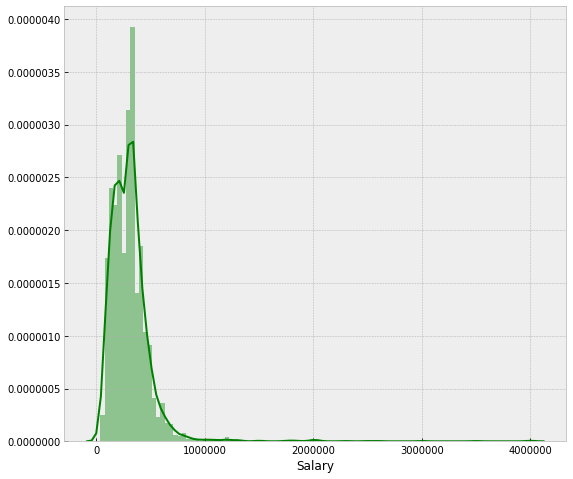

In [5]:
print(df['Salary'].describe())
plt.figure(figsize=(9, 8))
sns.distplot(df['Salary'], color='g', bins=100, hist_kws={'alpha': 0.4});

### Numerical Data Distribution <br>
To do so lets first list all the types of our data from our dataset and take only the numerical ones:

In [6]:
list(set(df.dtypes.tolist()))

[dtype('int64'), dtype('O'), dtype('float64')]

In [7]:
df_num = df.select_dtypes(include = ['float64', 'int64'])
df_num.head()

,ID,Salary,10percentage,12graduation,12percentage,CollegeID,CollegeTier,collegeGPA,CollegeCityID,CollegeCityTier,GraduationYear,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,203097,420000.0,84.3,2007,95.8,1141,2,78.00,1141,0,2011,515,585,525,0.635979,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,579905,500000.0,85.4,2007,85.0,5807,2,70.06,5807,0,2012,695,610,780,0.960603,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,810601,325000.0,85.0,2010,68.2,64,2,70.00,64,0,2014,615,545,370,0.450877,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,267447,1100000.0,85.6,2007,83.6,6920,1,74.64,6920,1,2011,635,585,625,0.974396,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,343523,200000.0,78.0,2008,76.8,11368,2,73.90,11368,0,2012,545,625,465,0.124502,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


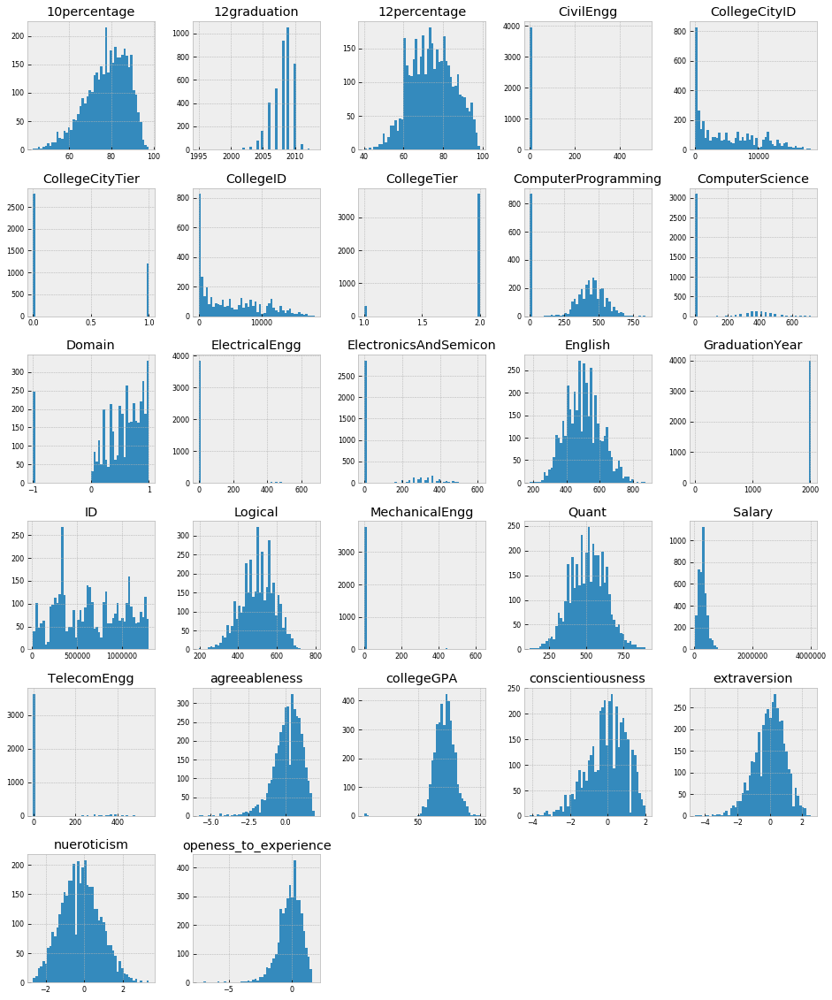

In [8]:
df_num.hist(figsize=(16, 20), bins=50, xlabelsize=8, ylabelsize=8); # ; avoid having the matplotlib verbose informations

### Insights from distribution of data <br>
10percentage, 12percentage, English, Logical, Quant have valid data for most rows <br>
Not considering conscientiousness, extraversion, nueroticism, openess_to_experience as these data elements are not described adequately in the data set <br>
Most of the other columns have zero value on a large number of rows <br> <br>
Some data distribution charts are shown below

count    3998.000000
mean       74.466366
std        10.999933
min        40.000000
25%        66.000000
50%        74.400000
75%        82.600000
max        98.700000
Name: 12percentage, dtype: float64


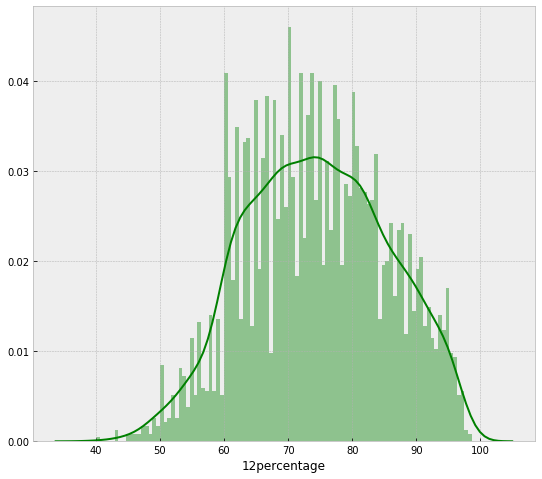

In [9]:
print(df['12percentage'].describe())
plt.figure(figsize=(9, 8))
sns.distplot(df['12percentage'], color='g', bins=100, hist_kws={'alpha': 0.4});

count    3998.000000
mean       74.466366
std        10.999933
min        40.000000
25%        66.000000
50%        74.400000
75%        82.600000
max        98.700000
Name: 12percentage, dtype: float64


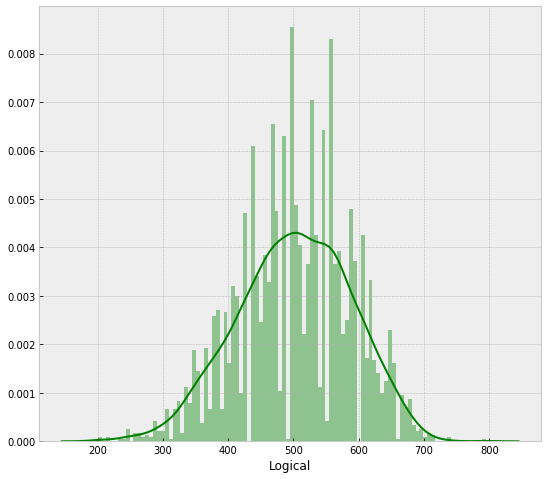

In [10]:
print(df['12percentage'].describe())
plt.figure(figsize=(9, 8))
sns.distplot(df['Logical'], color='g', bins=100, hist_kws={'alpha': 0.4});

### Evaluate correlation in data 

In [11]:
df_num_corr = df_num.corr()['Salary'][2:] # -1 because the latest row is SalePrice
golden_features_list = df_num_corr[abs(df_num_corr) > 0.1].sort_values(ascending=False)
print("There is {} correlated values with Salary:\n{}".format(len(golden_features_list), golden_features_list))

There is 13 correlated values with Salary:
Quant                  0.230627
Logical                0.179275
English                0.178219
10percentage           0.177373
12percentage           0.170254
collegeGPA             0.130103
ComputerProgramming    0.115665
Domain                 0.104656
ComputerScience       -0.100720
CollegeCityID         -0.118690
CollegeID             -0.118690
12graduation          -0.161383
CollegeTier           -0.179332
Name: Salary, dtype: float64


Correlation is not very high for most data elements

In [12]:
df_num.corr()

,ID,Salary,10percentage,12graduation,12percentage,CollegeID,CollegeTier,collegeGPA,CollegeCityID,CollegeCityTier,GraduationYear,English,Logical,Quant,Domain,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
ID,1.000000,-0.247294,0.044547,0.673102,0.007069,0.284540,0.035160,0.047144,0.284540,-0.035977,0.027539,0.135505,0.102215,-0.055134,-0.125639,0.018859,-0.115601,0.482626,-0.026147,0.104454,-0.049272,-0.017871,0.175557,0.024837,0.120979,-0.146289,0.031359
Salary,-0.247294,1.000000,0.177373,-0.161383,0.170254,-0.118690,-0.179332,0.130103,-0.118690,0.015384,-0.010053,0.178219,0.179275,0.230627,0.104656,0.115665,0.000665,-0.100720,0.018475,-0.047598,-0.022691,0.037639,-0.064148,0.057423,-0.010213,-0.054685,-0.011312
10percentage,0.044547,0.177373,1.000000,0.269957,0.643378,0.021082,-0.126042,0.312538,0.021082,0.116707,-0.013799,0.350780,0.316014,0.317640,0.078563,0.053600,0.085179,-0.018933,0.050364,0.074419,0.049378,0.030002,0.067657,0.136645,-0.004679,-0.132496,0.036692
12graduation,0.673102,-0.161383,0.269957,1.000000,0.259166,0.254021,0.027691,0.086001,0.254021,-0.003016,0.014457,0.147925,0.105887,0.001379,-0.034163,-0.047995,-0.005891,0.293439,0.035459,0.123751,0.023470,-0.004727,0.103329,0.041182,0.061956,-0.074369,-0.015069
12percentage,0.007069,0.170254,0.643378,0.259166,1.000000,0.022336,-0.100771,0.346137,0.022336,0.130462,-0.012933,0.212888,0.243571,0.312413,0.074099,0.080818,0.117112,-0.043534,0.037635,0.064001,0.044201,0.005910,0.058299,0.103998,-0.007486,-0.094369,0.006332
CollegeID,0.284540,-0.118690,0.021082,0.254021,0.022336,1.000000,0.067054,0.017240,1.000000,0.007757,-0.000172,-0.022792,-0.047094,-0.114672,-0.073857,-0.033760,-0.020438,0.102303,-0.009291,0.022933,0.025620,0.005749,0.076432,-0.005264,0.005917,-0.008973,-0.010678
CollegeTier,0.035160,-0.179332,-0.126042,0.027691,-0.100771,0.067054,1.000000,-0.086781,0.067054,-0.101494,-0.005557,-0.183843,-0.182811,-0.251103,-0.061436,-0.073644,-0.031573,0.001053,-0.021548,0.002594,0.000007,-0.033722,0.055174,-0.038055,0.009970,0.023778,-0.019179
collegeGPA,0.047144,0.130103,0.312538,0.086001,0.346137,0.017240,-0.086781,1.000000,0.017240,0.017471,0.008706,0.106478,0.196610,0.217380,0.107252,0.136596,0.029855,0.007601,-0.031765,0.052258,-0.005226,-0.018950,0.069582,0.068282,-0.032684,-0.074859,0.028071
CollegeCityID,0.284540,-0.118690,0.021082,0.254021,0.022336,1.000000,0.067054,0.017240,1.000000,0.007757,-0.000172,-0.022792,-0.047094,-0.114672,-0.073857,-0.033760,-0.020438,0.102303,-0.009291,0.022933,0.025620,0.005749,0.076432,-0.005264,0.005917,-0.008973,-0.010678
CollegeCityTier,-0.035977,0.015384,0.116707,-0.003016,0.130462,0.007757,-0.101494,0.017471,0.007757,1.000000,0.008152,0.050462,0.020353,0.007896,0.009250,0.064272,0.041083,-0.010643,-0.052395,0.010311,0.049876,-0.033392,0.014763,0.005565,-0.008203,0.004442,-0.016790


### Plot Correlation charts

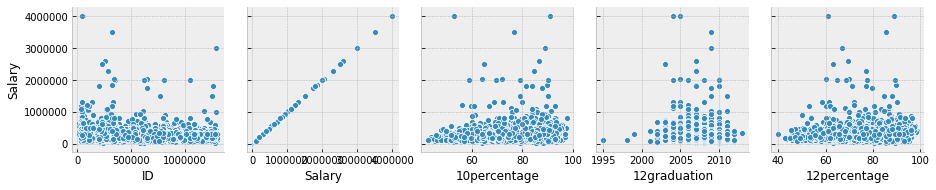

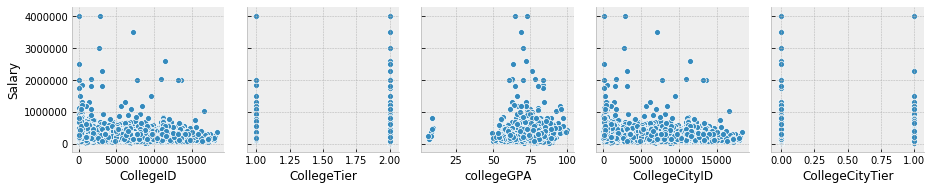

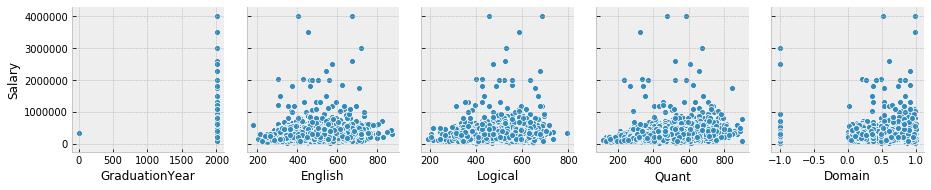

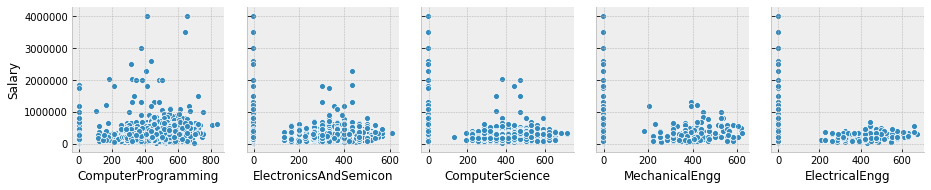

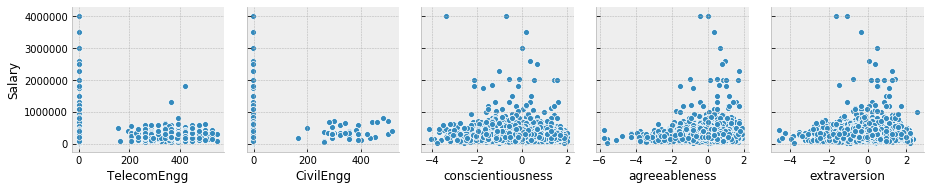

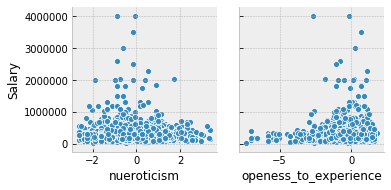

In [13]:
for i in range(0, len(df_num.columns), 5):
    sns.pairplot(data=df_num,
                x_vars=df_num.columns[i:i+5],
                y_vars=['Salary'])

### Identify features with the most relevant correlation

In [15]:
quantitative_features_list = ['10percentage','12percentage','English','Logical','Quant','Domain','Salary']
df_quantitative_features_list = df[quantitative_features_list]

In [16]:
features_to_analyse = quantitative_features_list

### Draw regression plots for a subset of features

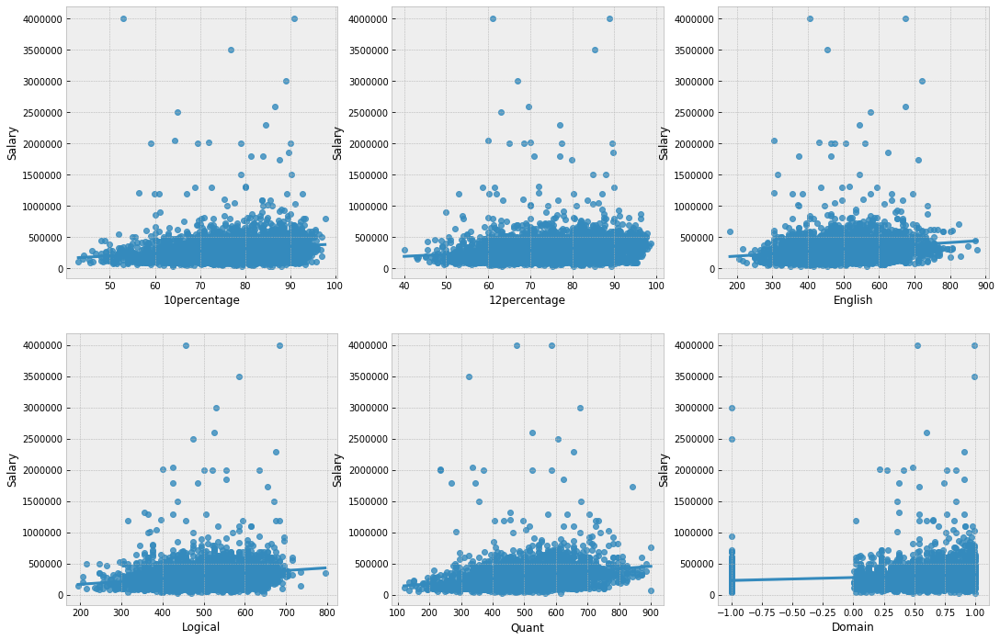

In [17]:
fig, ax = plt.subplots(round(len(features_to_analyse) / 3), 3, figsize = (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(features_to_analyse) - 1:
        sns.regplot(x=features_to_analyse[i],y='Salary', data=df[features_to_analyse], ax=ax)

### Identify Categorical features

In [19]:
# quantitative_features_list[:-1] as the last column is SalePrice and we want to keep it
categorical_features = [a for a in quantitative_features_list[:-1] + df.columns.tolist() if (a not in quantitative_features_list[:-1]) or (a not in df.columns.tolist())]
df_categ = df[categorical_features]
df_categ.head()

,Unnamed: 0,ID,Salary,DOJ,DOL,Designation,JobCity,Gender,DOB,10board,12graduation,12board,CollegeID,CollegeTier,Degree,Specialization,collegeGPA,CollegeCityID,CollegeCityTier,CollegeState,GraduationYear,ComputerProgramming,ElectronicsAndSemicon,ComputerScience,MechanicalEngg,ElectricalEngg,TelecomEngg,CivilEngg,conscientiousness,agreeableness,extraversion,nueroticism,openess_to_experience
0,train,203097,420000.0,6/1/2012 0:00,present,senior quality engineer,Bangalore,f,2/19/1990 0:00,"board ofsecondary education,ap",2007,"board of intermediate education,ap",1141,2,B.Tech/B.E.,computer engineering,78.00,1141,0,Andhra Pradesh,2011,445,-1,-1,-1,-1,-1,-1,0.9737,0.8128,0.5269,1.35490,-0.4455
1,train,579905,500000.0,9/1/2013 0:00,present,assistant manager,Indore,m,10/4/1989 0:00,cbse,2007,cbse,5807,2,B.Tech/B.E.,electronics and communication engineering,70.06,5807,0,Madhya Pradesh,2012,-1,466,-1,-1,-1,-1,-1,-0.7335,0.3789,1.2396,-0.10760,0.8637
2,train,810601,325000.0,6/1/2014 0:00,present,systems engineer,Chennai,f,8/3/1992 0:00,cbse,2010,cbse,64,2,B.Tech/B.E.,information technology,70.00,64,0,Uttar Pradesh,2014,395,-1,-1,-1,-1,-1,-1,0.2718,1.7109,0.1637,-0.86820,0.6721
3,train,267447,1100000.0,7/1/2011 0:00,present,senior software engineer,Gurgaon,m,12/5/1989 0:00,cbse,2007,cbse,6920,1,B.Tech/B.E.,computer engineering,74.64,6920,1,Delhi,2011,615,-1,-1,-1,-1,-1,-1,0.0464,0.3448,-0.3440,-0.40780,-0.9194
4,train,343523,200000.0,3/1/2014 0:00,3/1/2015 0:00,get,Manesar,m,2/27/1991 0:00,cbse,2008,cbse,11368,2,B.Tech/B.E.,electronics and communication engineering,73.90,11368,0,Uttar Pradesh,2012,-1,233,-1,-1,-1,-1,-1,-0.8810,-0.2793,-1.0697,0.09163,-0.1295


Remove features not being considered for analysis

In [20]:
cols_to_be_removed = ['ID','DOJ','DOB','CollegeID','collegeGPA','CollegeCityID','ComputerProgramming', 'ElectronicsAndSemicon','Unnamed: 0',
 'Salary',
 'ComputerScience',
 'MechanicalEngg',
 'ElectricalEngg',
 'TelecomEngg',
 'CivilEngg',
 'conscientiousness',
 'agreeableness',
 'extraversion',
 'nueroticism',
 'openess_to_experience',
 'DOL']
categorical_features_1=[]
categorical_features_1 = [a for a in categorical_features if (a not in cols_to_be_removed)]
categorical_features_1.append('Salary')
categorical_features_1

['Designation',
 'JobCity',
 'Gender',
 '10board',
 '12graduation',
 '12board',
 'CollegeTier',
 'Degree',
 'Specialization',
 'CollegeCityTier',
 'CollegeState',
 'GraduationYear',
 'Salary']

In [21]:
df_categ = df[categorical_features_1]
df_categ.head()

,Designation,JobCity,Gender,10board,12graduation,12board,CollegeTier,Degree,Specialization,CollegeCityTier,CollegeState,GraduationYear,Salary
0,senior quality engineer,Bangalore,f,"board ofsecondary education,ap",2007,"board of intermediate education,ap",2,B.Tech/B.E.,computer engineering,0,Andhra Pradesh,2011,420000.0
1,assistant manager,Indore,m,cbse,2007,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Madhya Pradesh,2012,500000.0
2,systems engineer,Chennai,f,cbse,2010,cbse,2,B.Tech/B.E.,information technology,0,Uttar Pradesh,2014,325000.0
3,senior software engineer,Gurgaon,m,cbse,2007,cbse,1,B.Tech/B.E.,computer engineering,1,Delhi,2011,1100000.0
4,get,Manesar,m,cbse,2008,cbse,2,B.Tech/B.E.,electronics and communication engineering,0,Uttar Pradesh,2012,200000.0


In [22]:
df_not_num = df_categ.select_dtypes(include = ['O'])
print('There is {} non numerical features including:\n{}'.format(len(df_not_num.columns), df_not_num.columns.tolist()))

There is 8 non numerical features including:
['Designation', 'JobCity', 'Gender', '10board', '12board', 'Degree', 'Specialization', 'CollegeState']


In [23]:
# Add two more category columns 'CollegeTier' and 'CollegeCityTier' though they are numeric
categorical_features_1 = df_not_num.columns.tolist()
categorical_features_1.append('CollegeTier')
categorical_features_1.append('CollegeCityTier')
df_not_num = df[categorical_features_1]


### Plot charts to understand distribution of data

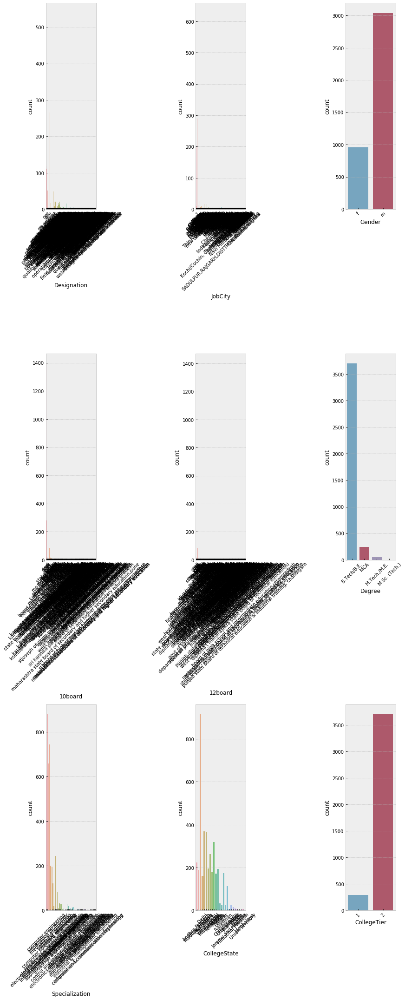

In [24]:
fig, axes = plt.subplots(round(len(df_not_num.columns) / 3), 3, figsize=(12, 30))

for i, ax in enumerate(fig.axes):
    if i < len(df_not_num.columns):
        ax.set_xticklabels(ax.xaxis.get_majorticklabels(), rotation=45)
        sns.countplot(x=df_not_num.columns[i], alpha=0.7, data=df_not_num, ax=ax)

fig.tight_layout()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25]),
 <a list of 26 Text xticklabel objects>)

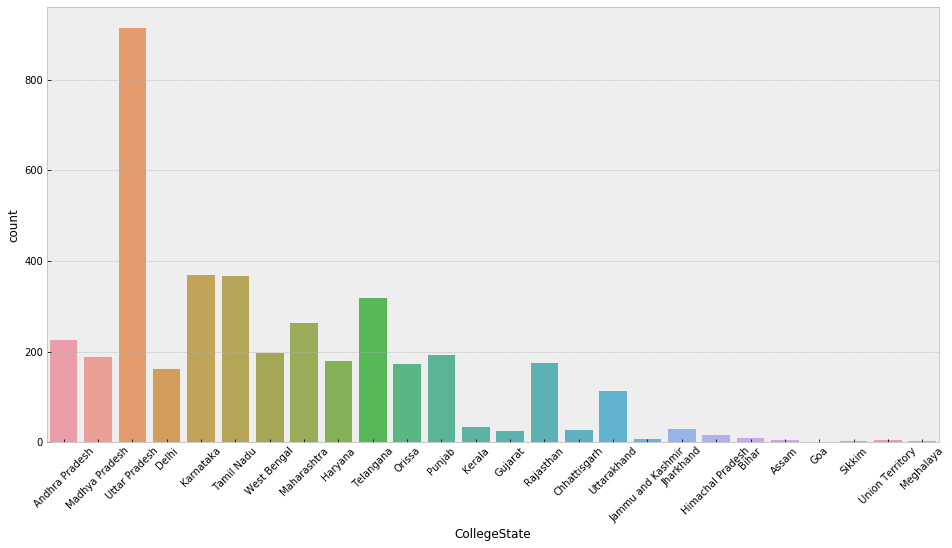

In [25]:
plt.figure(figsize = (16, 8))

ax = sns.countplot(x = 'CollegeState',alpha=0.9, data=df_not_num)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25]),
 <a list of 26 Text xticklabel objects>)

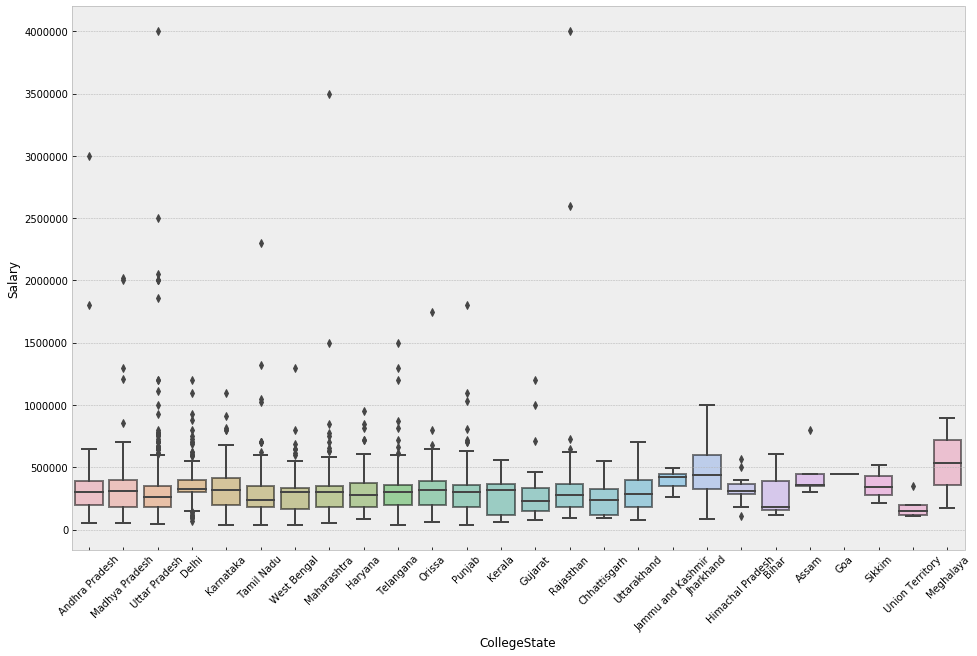

In [26]:
plt.figure(figsize = (16, 10))
ax = sns.boxplot(x='CollegeState', y='Salary', data=df_categ)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45]),
 <a list of 46 Text xticklabel objects>)

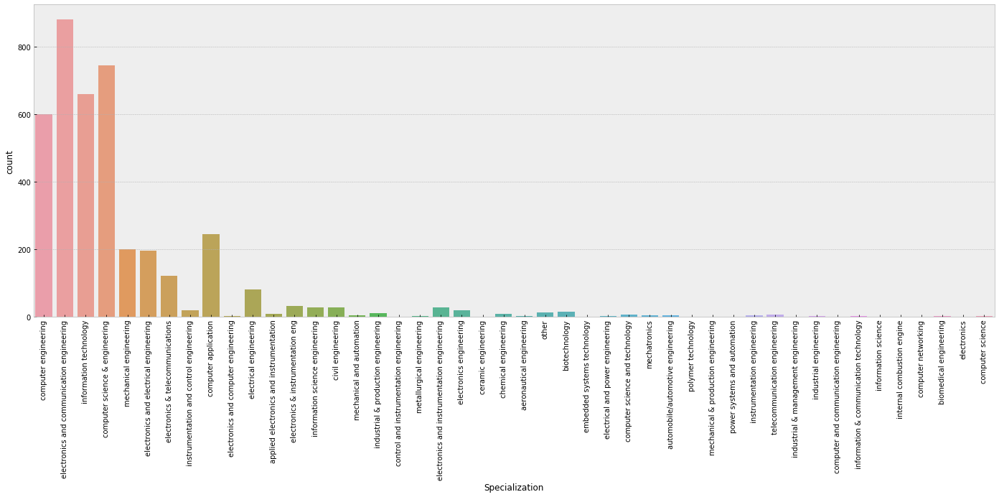

In [27]:
plt.figure(figsize = (24, 8))

ax = sns.countplot(x = 'Specialization',alpha=0.9, data=df_not_num)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=90)

## Multiple Linear Regression

In [28]:
from sklearn import linear_model
lm1 = linear_model.LinearRegression()

### Split data into train and test

In [29]:
msk = np.random.rand(len(df)) < 0.8
train = df_quantitative_features_list[msk]
test = df_quantitative_features_list[~msk]

In [31]:
columns_for_regression = ['10percentage','12percentage','English','Logical','Quant','Domain']
x = np.asanyarray(train[columns_for_regression])
y = np.asanyarray(train[['Salary']])
lm1.fit(x,y)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [32]:
lm1.coef_

array([[  852.39702613,  1416.99541726,   176.97876278,    86.31073346,
          212.99132784, 19859.35136246]])

The coefficients corresponding to the features 10percentage and 12percentage indicate that these features have a higher influence on the outcome than the other variables. 

### Quikcly validate model by using it to predict salary based on couple of sets of sample values

In [33]:
# Sample prediction
# ['10percentage','12percentage','English','Logical','Quant','Domain']
y_hat = lm1.predict([[80,78,600,600,600,1]])
print('Predicted Salary: %.2f' % y_hat)

# Sample prediction
# ['10percentage','12percentage','English','Logical','Quant','Domain']
y_hat = lm1.predict([[50,48,200,200,200,0.5]])
print('Predicted Salary: %.2f' % y_hat)

Predicted Salary: 368015.05
Predicted Salary: 99491.28


Predictions appear to be well within the range of the sample data. 


### Use model to make predictions using test data

In [34]:
y_hat = lm1.predict(test[['10percentage','12percentage','English','Logical','Quant','Domain']])
y = np.asanyarray(test[['Salary']])
x = np.asanyarray(test[['10percentage','12percentage','English','Logical','Quant','Domain']])

print("Residual sum of squares: %.2f" % np.mean((y_hat - y) ** 2))

# Explained variance score: 1 is perfect prediction
print('Variance score: %.2f' % lm1.score(x, y))

Residual sum of squares: 34341001551.08
Variance score: 0.11


## Classification Aproach<br>
Bin the records into various salary ranges and use Multi-Class Classification approach to predict a salary range

### Create a new column named bin <br>
with values 'upto100K', '100to200K','200to300K','300to400K','400to500K','500to4000K' based on the Salary cplumn

In [35]:
df['bin'] = pd.cut(df['Salary'], [0, 100000, 200000,300000,400000,500000,4000000], labels=['upto100K', '100to200K','200to300K','300to400K','400to500K','500to4000K'])


(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text xticklabel objects>)

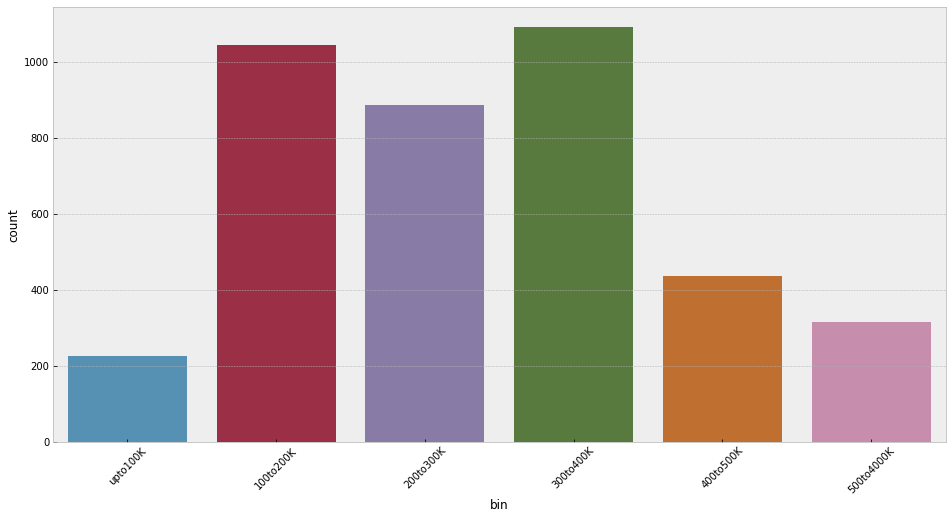

In [36]:
plt.figure(figsize = (16, 8))

ax = sns.countplot(x = 'bin',alpha=0.9, data=df)
plt.setp(ax.artists, alpha=.5, linewidth=2, edgecolor="k")
plt.xticks(rotation=45)

### Prepare a new dataframe with columns relevant for classification <br>
Used all numerical features from regression model <br>
Used categorical features with demographic data such as location, gender, college along with educational qualification

In [37]:

columns_for_classification = columns_for_regression+categorical_features_1
columns_for_classification.append('bin')
columns_for_classification.append('Salary')
df_class = df[columns_for_classification]
df_class.head()

,10percentage,12percentage,English,Logical,Quant,Domain,Designation,JobCity,Gender,10board,12board,Degree,Specialization,CollegeState,CollegeTier,CollegeCityTier,bin,Salary
0,84.3,95.8,515,585,525,0.635979,senior quality engineer,Bangalore,f,"board ofsecondary education,ap","board of intermediate education,ap",B.Tech/B.E.,computer engineering,Andhra Pradesh,2,0,400to500K,420000.0
1,85.4,85.0,695,610,780,0.960603,assistant manager,Indore,m,cbse,cbse,B.Tech/B.E.,electronics and communication engineering,Madhya Pradesh,2,0,400to500K,500000.0
2,85.0,68.2,615,545,370,0.450877,systems engineer,Chennai,f,cbse,cbse,B.Tech/B.E.,information technology,Uttar Pradesh,2,0,300to400K,325000.0
3,85.6,83.6,635,585,625,0.974396,senior software engineer,Gurgaon,m,cbse,cbse,B.Tech/B.E.,computer engineering,Delhi,1,1,500to4000K,1100000.0
4,78.0,76.8,545,625,465,0.124502,get,Manesar,m,cbse,cbse,B.Tech/B.E.,electronics and communication engineering,Uttar Pradesh,2,0,100to200K,200000.0


### Prepare train and test data

In [38]:
msk = np.random.rand(len(df)) < 0.8
train = df_class[msk]
test = df_class[~msk]

In [39]:
train.head()

,10percentage,12percentage,English,Logical,Quant,Domain,Designation,JobCity,Gender,10board,12board,Degree,Specialization,CollegeState,CollegeTier,CollegeCityTier,bin,Salary
1,85.40,85.0,695,610,780,0.960603,assistant manager,Indore,m,cbse,cbse,B.Tech/B.E.,electronics and communication engineering,Madhya Pradesh,2,0,400to500K,500000.0
2,85.00,68.2,615,545,370,0.450877,systems engineer,Chennai,f,cbse,cbse,B.Tech/B.E.,information technology,Uttar Pradesh,2,0,300to400K,325000.0
3,85.60,83.6,635,585,625,0.974396,senior software engineer,Gurgaon,m,cbse,cbse,B.Tech/B.E.,computer engineering,Delhi,1,1,500to4000K,1100000.0
4,78.00,76.8,545,625,465,0.124502,get,Manesar,m,cbse,cbse,B.Tech/B.E.,electronics and communication engineering,Uttar Pradesh,2,0,100to200K,200000.0
5,89.92,87.0,560,555,620,-1.000000,system engineer,Hyderabad,m,state board,state board,B.Tech/B.E.,electronics and communication engineering,Karnataka,2,0,200to300K,300000.0


### Separate out predictors and outcome values

In [40]:
# Seperating Predictors and Outcome values from train and test sets
X_train = pd.DataFrame(train.drop(['bin','Salary'],axis=1))
Y_train_label = train['bin'].values
X_test = pd.DataFrame(test.drop(['bin','Salary'],axis=1))
Y_test_label = test['bin'].values
#Y_test_label = train['bin'].values.astype(object)

In [37]:
X_train.head()

,10percentage,12percentage,English,Logical,Quant,Domain,Unnamed: 0,DOJ,DOL,Designation,JobCity,Gender,DOB,10board,12board,Degree,Specialization,CollegeState,CollegeTier,CollegeCityTier
0,84.30,95.8,515,585,525,0.635979,train,6/1/2012 0:00,present,senior quality engineer,Bangalore,f,2/19/1990 0:00,"board ofsecondary education,ap","board of intermediate education,ap",B.Tech/B.E.,computer engineering,Andhra Pradesh,2,0
1,85.40,85.0,695,610,780,0.960603,train,9/1/2013 0:00,present,assistant manager,Indore,m,10/4/1989 0:00,cbse,cbse,B.Tech/B.E.,electronics and communication engineering,Madhya Pradesh,2,0
2,85.00,68.2,615,545,370,0.450877,train,6/1/2014 0:00,present,systems engineer,Chennai,f,8/3/1992 0:00,cbse,cbse,B.Tech/B.E.,information technology,Uttar Pradesh,2,0
3,85.60,83.6,635,585,625,0.974396,train,7/1/2011 0:00,present,senior software engineer,Gurgaon,m,12/5/1989 0:00,cbse,cbse,B.Tech/B.E.,computer engineering,Delhi,1,1
5,89.92,87.0,560,555,620,-1.000000,train,6/1/2014 0:00,present,system engineer,Hyderabad,m,7/2/1992 0:00,state board,state board,B.Tech/B.E.,electronics and communication engineering,Karnataka,2,0


### Define pipelines to process numeric / continuous features and categorical features

In [41]:
# Define the list of numeric/continuous features and categorical features
numeric_features = ['10percentage', '12percentage', 'English', 'Logical', 'Quant', 'Domain']
categorical_features = ['Designation', 'JobCity', 'Gender', '10board', '12board', 'Degree', 'Specialization', 'CollegeState', 'CollegeTier', 'CollegeCityTier']

# Pipeline to process categorical features through One Hot Encoder
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder

categorical_transformer = Pipeline(steps=[
    ('onehot', OneHotEncoder(handle_unknown='ignore')),
])

# Pipeline to process numeric features through Simple Imputer and Standard Scaler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler

numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler()),
])

#Column transformer to process both types of columns
from sklearn.compose import ColumnTransformer

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ]
)

### Separate Features and Result Values

In [42]:
# Seperating Predictors and Outcome values from train and test sets
X_train = pd.DataFrame(train.drop(['bin','Salary'],axis=1))
Y_train_label = train['bin'].values.astype(object)
X_test = pd.DataFrame(test.drop(['bin','Salary'],axis=1))
Y_test_label = test['bin'].values.astype(object)

# Dimension of Train and Test set 
print("Dimension of Train set",X_train.shape)
print("Dimension of Test set",X_test.shape,"\n")



Dimension of Train set (3182, 16)
Dimension of Test set (816, 16) 



### Encode Training and Test Labels using Label Encoder

In [43]:
# Transforming non numerical labels into numerical labels
from sklearn import preprocessing
encoder = preprocessing.LabelEncoder()

# encoding train labels 
encoder.fit(Y_train_label)
Y_train = encoder.transform(Y_train_label)

# encoding test labels 
encoder.fit(Y_test_label)
Y_test = encoder.transform(Y_test_label)

### Training SVM model using radial kernel

In [44]:
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.model_selection import cross_val_score, GridSearchCV


In [45]:
# Performing CV to tune parameters for best SVM fit 

pipe = Pipeline([
     ('preprocessor', preprocessor),
     ('classifier', SVC(kernel="rbf", C=1, probability=True))
])

pipe.fit(X_train, Y_train)
#CV = GridSearchCV(clf, params_grid, cv=5)
#CV.fit(X_train, Y_train)


Pipeline(memory=None,
         steps=[('preprocessor',
                 ColumnTransformer(n_jobs=None, remainder='drop',
                                   sparse_threshold=0.3,
                                   transformer_weights=None,
                                   transformers=[('num',
                                                  Pipeline(memory=None,
                                                           steps=[('imputer',
                                                                   SimpleImputer(add_indicator=False,
                                                                                 copy=True,
                                                                                 fill_value=None,
                                                                                 missing_values=nan,
                                                                                 strategy='median',
                                                             

In [46]:
print("model score: %.3f" % pipe.score(X_test, Y_test))

model score: 0.417


In [47]:
Y_pred = pipe.predict(X_test)

In [48]:
Y_pred_label = list(encoder.inverse_transform(Y_pred))

### Confusion Matrix and Accuracy Score

In [50]:
# Making the Confusion Matrix
#print(pd.crosstab(Y_test_label, Y_pred_label, rownames=['Actual Activity'], colnames=['Predicted Activity']))
print(confusion_matrix(Y_test_label,Y_pred_label))
print("\n")
print(classification_report(Y_test_label,Y_pred_label))

#print("Training set score for SVM: %f" % final_model.score(X_train_scaled , Y_train))
#print("Testing  set score for SVM: %f" % final_model.score(X_test_scaled  , Y_test ))



[[146  34  30   0   0   0]
 [ 75  20  64   1   0   0]
 [ 45  21 159  12   0   0]
 [ 17   8  50  12   0   0]
 [ 22   5  40   8   3   0]
 [ 37   2   5   0   0   0]]


              precision    recall  f1-score   support

   100to200K       0.43      0.70      0.53       210
   200to300K       0.22      0.12      0.16       160
   300to400K       0.46      0.67      0.54       237
   400to500K       0.36      0.14      0.20        87
  500to4000K       1.00      0.04      0.07        78
    upto100K       0.00      0.00      0.00        44

    accuracy                           0.42       816
   macro avg       0.41      0.28      0.25       816
weighted avg       0.42      0.42      0.35       816



### Evaluate a set of classifiers

In [51]:
from sklearn.metrics import accuracy_score, log_loss
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC, LinearSVC, NuSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis

In [52]:
classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="rbf", C=0.025, probability=True),
    DecisionTreeClassifier(),
    RandomForestClassifier(),
    AdaBoostClassifier(),
    GradientBoostingClassifier()
    ]
for classifier in classifiers:
    pipe = Pipeline(steps=[('preprocessor', preprocessor),
                      ('classifier', classifier)])
    pipe.fit(X_train, Y_train)   
    print(classifier)
    print("model score: %.3f" % pipe.score(X_test, Y_test))

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=3, p=2,
                     weights='uniform')
model score: 0.320
SVC(C=0.025, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=True, random_state=None, shrinking=True, tol=0.001,
    verbose=False)
model score: 0.387
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')
model score: 0.275
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
     

Best score comes from GradientBoostingClassifier

### Build model that provides best score <br>
GradientBoostingClassifier has the best score here

In [60]:
rf = Pipeline([
     ('preprocessor', preprocessor),
     ('classifier', GradientBoostingClassifier(max_depth=4, min_samples_split=2, min_samples_leaf=1, subsample=1,max_features='sqrt', random_state=10))
]) 

In [61]:
rf.fit (X_train, Y_train)

Pipeline(memory=None,
         steps=[('preprocessor',
                 ColumnTransformer(n_jobs=None, remainder='drop',
                                   sparse_threshold=0.3,
                                   transformer_weights=None,
                                   transformers=[('num',
                                                  Pipeline(memory=None,
                                                           steps=[('imputer',
                                                                   SimpleImputer(add_indicator=False,
                                                                                 copy=True,
                                                                                 fill_value=None,
                                                                                 missing_values=nan,
                                                                                 strategy='median',
                                                             

In [62]:
Y_pred = rf.predict(X_test)
Y_pred_label = list(encoder.inverse_transform(Y_pred))

### Confusion Matrix and Accuracy Score

In [64]:
Y_pred = rf.predict(X_test)
Y_pred_label = list(encoder.inverse_transform(Y_pred))

In [65]:
# Making the Confusion Matrix
#print(pd.crosstab(Y_test_label, Y_pred_label, rownames=['Actual Activity'], colnames=['Predicted Activity']))
print(confusion_matrix(Y_test_label,Y_pred_label))
print("\n")
print(classification_report(Y_test_label,Y_pred_label))

[[151  20  33   2   3   1]
 [ 70  24  65   1   0   0]
 [ 39  24 157  11   3   3]
 [ 17   9  45  15   0   1]
 [ 19  11  32   7   9   0]
 [ 34   4   6   0   0   0]]


              precision    recall  f1-score   support

   100to200K       0.46      0.72      0.56       210
   200to300K       0.26      0.15      0.19       160
   300to400K       0.46      0.66      0.55       237
   400to500K       0.42      0.17      0.24        87
  500to4000K       0.60      0.12      0.19        78
    upto100K       0.00      0.00      0.00        44

    accuracy                           0.44       816
   macro avg       0.37      0.30      0.29       816
weighted avg       0.41      0.44      0.38       816



In [66]:
print("model score: %.3f" % rf.score(X_test, Y_test))

model score: 0.436
